In [1]:
pip install geojson

  Using cached geojson-3.1.0-py3-none-any.whl (15 kB)
Note: you may need to restart the kernel to use updated packages.


In [2]:
pip install h3

  Using cached h3-3.7.7-cp39-cp39-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (1.2 MB)
Note: you may need to restart the kernel to use updated packages.


In [ ]:
# Restart Kernel

In [1]:
import geopandas as gpd
import numpy as np

In [2]:
import h3

In [3]:
from shapely.geometry import Polygon

In [4]:
from geojson import Feature
from geojson import FeatureCollection

In [5]:
import plotly.express as px

In [6]:
%matplotlib inline 
import numpy as np 
import matplotlib.pyplot as plt 
import pandas as pd

In [7]:
def geo_to_h3(row):
  return h3.geo_to_h3(lat=row.position_latitude, lng=row.position_longitude, resolution = H3_res)

In [8]:
df1 = pd.read_csv("../data/latlon1.csv")

In [9]:
df1

,position_latitude,position_longitude,median_vehicle_message_age
0,34.064957,-118.23702,0.5
1,36.311160,-119.31405,0.5
2,34.037285,-118.27012,0.5
3,34.042084,-118.25213,0.5
4,34.534897,-117.29126,0.5
...,...,...,...
1139374,34.046364,-118.44865,205200.0
1139375,34.062477,-118.44547,205214.0
1139376,33.987404,-118.46891,205217.0
1139377,34.294926,-118.85718,507048.0


In [10]:
H3_res = 6

In [11]:
df1['h3_cell'] = df1.apply(geo_to_h3,axis=1)

In [12]:
df1

,position_latitude,position_longitude,median_vehicle_message_age,h3_cell
0,34.064957,-118.23702,0.5,8629a1d77ffffff
1,36.311160,-119.31405,0.5,8629a8447ffffff
2,34.037285,-118.27012,0.5,8629a1d67ffffff
3,34.042084,-118.25213,0.5,8629a1d77ffffff
4,34.534897,-117.29126,0.5,8629a39a7ffffff
...,...,...,...,...
1139374,34.046364,-118.44865,205200.0,8629a1987ffffff
1139375,34.062477,-118.44547,205214.0,8629a199fffffff
1139376,33.987404,-118.46891,205217.0,8629a19a7ffffff
1139377,34.294926,-118.85718,507048.0,8629a1bafffffff


In [13]:
df1_res6_g = (df1
              .groupby('h3_cell')
              .median_vehicle_message_age
              .agg(list)
              .to_frame("medians")
              .reset_index())
# Let's aggregate medians of VP messages ages inside the hexagon
df1_res6_g['average'] = (df1_res6_g['medians'].apply(lambda x:round(np.mean(x))))

In [14]:
df1_res6_g.sort_values('average',ascending=False)

,h3_cell,medians,average
645,8629a1b07ffffff,[25440.0],25440
578,8629a1187ffffff,"[25318.0, 25333.0, 25384.0, 25405.0, 25409.0, ...",25435
579,8629a118fffffff,"[25299.0, 25549.0]",25424
605,8629a156fffffff,"[25345.0, 25394.0, 25404.0, 25431.0, 25434.0, ...",25417
604,8629a1567ffffff,"[25368.0, 25400.0, 25412.0, 25439.0, 25443.0]",25412
...,...,...,...
351,862913687ffffff,[1.0],1
643,8629a1a2fffffff,"[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",1
373,8629898afffffff,"[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 2.0, ...",1
372,8629898a7ffffff,"[1.0, 1.0, 1.0, 2.0]",1


In [15]:
def add_geometry(row):
  points = h3.h3_to_geo_boundary(row['h3_cell'], True)
  return Polygon(points)

In [16]:
#Apply function into our dataframe
df1_res6_g['geometry'] = (df1_res6_g.apply(add_geometry,axis=1))

In [17]:
df1_res6_g

,h3_cell,medians,average,geometry
0,86280204fffffff,"[18.0, 18.0]",18,POLYGON ((-123.81093836351411 40.8456945376117...
1,86280205fffffff,"[1.0, 1.0, 2.0, 3.0, 6.0, 11.0]",4,POLYGON ((-123.73682885062622 40.8635220019534...
2,862802267ffffff,"[1.0, 1.5, 2.0, 2.0, 2.0, 2.5, 2.5, 3.0, 3.0, ...",3,POLYGON ((-124.1514235397736 41.01932986260343...
3,862802277ffffff,[5.0],5,POLYGON ((-124.07742033295509 41.0373683340255...
4,862802307ffffff,[11.0],11,POLYGON ((-123.93822693353889 40.8662327347108...
...,...,...,...,...
1141,864859267ffffff,"[29.0, 29.0, 32.0, 35.0, 38.0, 38.0, 38.0, 39....",53,POLYGON ((-116.57491729616444 32.5821138517492...
1142,864859277ffffff,"[33.0, 33.0, 33.0, 33.0, 33.0, 33.0, 33.0, 42....",45,POLYGON ((-116.50256824290217 32.5951125977541...
1143,86485934fffffff,"[28.0, 32.0, 38.0, 38.0, 38.0, 38.0, 38.0, 38....",45,POLYGON ((-116.59882442183249 32.5230371561111...
1144,86485935fffffff,"[32.0, 33.0, 33.0, 33.0, 35.0, 35.0, 38.0, 39....",44,POLYGON ((-116.52652226387562 32.5360442489253...


In [18]:
def hexagons_dataframe_to_geojson(df_hex, hex_id_field, geometry_field, value_field, file_output = None):
    """
    Produce the GeoJSON for a dataframe that has a geometry column in geojson 
    format already, along with the columns hex_id and value
    
    Ex counts_by_hexagon(data)
    """    
    list_features = []
    
    for i,row in df_hex.iterrows():
        feature = Feature(geometry = row[geometry_field] , id=row[hex_id_field], properties = {"value" : row[value_field]})
        list_features.append(feature)
        
    feat_collection = FeatureCollection(list_features)
    
    # geojson_result = json.dumps(feat_collection)
    
    #optionally write to file
    if file_output is not None:
        with open(file_output,"w") as f:
            json.dump(feat_collection,f)
    else: 
        # return geojson_result
        return feat_collection


In [19]:
geojson_obj = (hexagons_dataframe_to_geojson
                (df1_res6_g,
                 hex_id_field='h3_cell',
                 value_field='average',
                 geometry_field='geometry'))

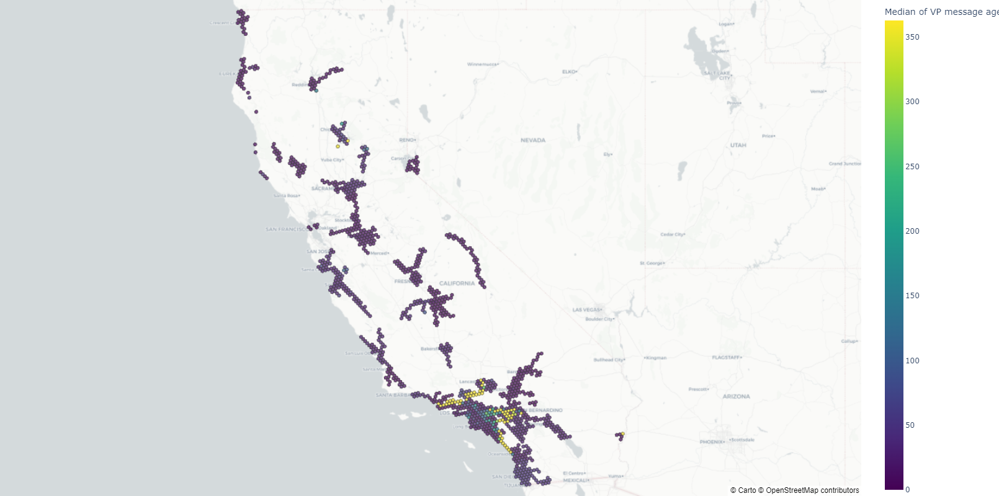

In [20]:
fig = (px.choropleth_mapbox(
                    df1_res6_g, 
                    geojson=geojson_obj, 
                    locations='h3_cell', 
                    color='average',
                    color_continuous_scale="Viridis",
                    range_color=(0,df1_res6_g['average'].mean()           ),
                    mapbox_style='carto-positron',
                    width=1200,
                    height = 800,
                    zoom=5.5,
                    center = {"lat": 37.40, "lon": -119.4179},
                    opacity=0.7,
                    labels={'average':'Median of VP message age'}))
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [21]:
df11 = pd.read_csv("../data/latlon1.csv")

In [22]:
H3_res = 7

In [23]:
df11['h3_cell'] = df11.apply(geo_to_h3,axis=1)

In [24]:
df11_res7_g = (df11
               .groupby('h3_cell')
               .median_vehicle_message_age
               .agg(list)
               .to_frame("medians")
               .reset_index())
# Let's aggregate medians of VP messages ages inside the hexagon
df11_res7_g['average'] =(df11_res7_g['medians'].apply(lambda x:round(np.mean(x))))

In [25]:
df11_res7_g.sort_values('average',ascending=False)

,h3_cell,medians,average
2070,8729a11abffffff,[25453.0],25453
2063,8729a1182ffffff,"[25384.0, 25416.0, 25475.0, 25505.0]",25445
2064,8729a1183ffffff,"[25333.0, 25412.0, 25414.0, 25425.0, 25471.0, ...",25442
2067,8729a1193ffffff,[25432.0],25432
2864,8729a4283ffffff,"[25288.0, 25299.0, 25316.0, 25334.0, 25366.0, ...",25420
...,...,...,...
3527,8729a8472ffffff,"[1.0, 1.0, 2.0]",1
2374,8729a1bb4ffffff,[1.0],1
2403,8729a1c63ffffff,"[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",1
2412,8729a1c6effffff,"[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",1


In [26]:
#Apply function into our dataframe
df11_res7_g['geometry'] = (df11_res7_g.apply(add_geometry,axis=1))

In [27]:
geojson_obj = (hexagons_dataframe_to_geojson
                (df11_res7_g,
                 hex_id_field='h3_cell',
                 value_field='average',
                 geometry_field='geometry'))

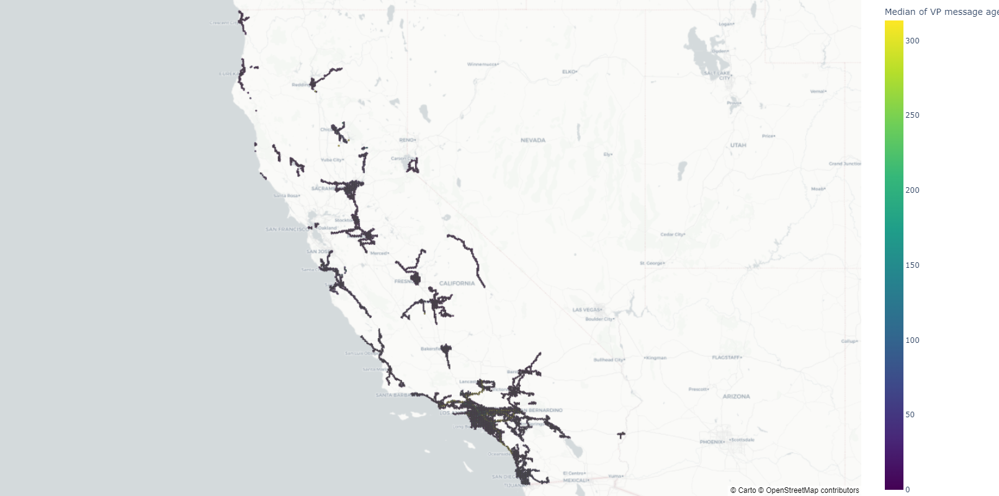

In [28]:
fig = (px.choropleth_mapbox(
                    df11_res7_g, 
                    geojson=geojson_obj, 
                    locations='h3_cell', 
                    color='average',
                    color_continuous_scale="Viridis",
                    range_color=(0,df11_res7_g['average'].mean()           ),
                    mapbox_style='carto-positron',
                    width=1200,
                    height = 800,
                    zoom=5.5,
                    center = {"lat": 37.40, "lon": -119.4179},
                    opacity=0.7,
                    labels={'average':'Median of VP message age'}))
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [29]:
df2 = pd.read_csv("../data/latlon2.csv")

In [30]:
df2.head()

,position_latitude,position_longitude,median_vehicle_message_age
0,33.807930,-117.91587,0.5
1,34.013780,-118.28267,0.5
2,34.051113,-118.27296,0.5
3,34.054615,-118.29545,0.5
4,34.168790,-118.32158,0.5


In [31]:
H3_res = 7

In [32]:
df2['h3_cell'] = df2.apply(geo_to_h3,axis=1)

In [33]:
df2_res7_g = (df2
              .groupby('h3_cell')
              .median_vehicle_message_age
              .agg(list)
              .to_frame("medians")
              .reset_index())
# Let's aggregate medians of VP messages ages inside the hexagon
df2_res7_g['max'] =(df2_res7_g['medians'].apply(lambda x:round(np.max(x))))

In [34]:
df2_res7_g.sort_values('max',ascending=False)

,h3_cell,medians,max
4889,8729b5d50ffffff,"[0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 1.0, ...",672980
2857,8729a1bacffffff,"[0.5, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",517918
2466,8729a1126ffffff,"[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",491949
2680,8729a188effffff,"[0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, ...",488919
2775,8729a19a3ffffff,"[0.5, 0.5, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",234007
...,...,...,...
2632,8729a17a8ffffff,[1.0],1
1661,87298d659ffffff,[1.0],1
22,87280232affffff,[1.0],1
2834,8729a1b46ffffff,"[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",1


In [35]:
#Apply function into our dataframe
df2_res7_g['geometry'] = (df2_res7_g.apply(add_geometry,axis=1))

In [36]:
geojson_obj = (hexagons_dataframe_to_geojson
                (df2_res7_g,
                 hex_id_field='h3_cell',
                 value_field='max',
                 geometry_field='geometry'))

In [37]:
fig = (px.choropleth_mapbox(
                    df2_res7_g, 
                    geojson=geojson_obj, 
                    locations='h3_cell', 
                    color='max',
                    color_continuous_scale="plasma",
                    range_color=(0,df2_res7_g['max'].mean()*10),
                    mapbox_style='open-street-map',
                    width=1200,
                    height = 800,
                    zoom=5.5,
                    center = {"lat": 37.40, "lon": -119.4179},
                    opacity=0.6,
                    labels={'max':'Latency'}))
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [38]:
df3 = pd.read_csv("../data/latlon3.csv")

In [39]:
df3.head()

,position_latitude,position_longitude,_vehicle_message_age
0,40.116520,-123.803140,-14
1,33.789910,-118.216500,59
2,38.553880,-121.372630,58
3,32.761250,-117.168410,64
4,32.629967,-117.094025,63


In [40]:
H3_res = 7

In [41]:
df3['h3_cell'] = df3.apply(geo_to_h3,axis=1)

In [42]:
df3.head()

,position_latitude,position_longitude,_vehicle_message_age,h3_cell
0,40.116520,-123.803140,-14,8728062f2ffffff
1,33.789910,-118.216500,59,8729a5611ffffff
2,38.553880,-121.372630,58,87283284affffff
3,32.761250,-117.168410,64,8729a4036ffffff
4,32.629967,-117.094025,63,8729a4c4effffff


In [43]:
df3_res7_g = (df3
              .groupby('h3_cell')
              ._vehicle_message_age
              .agg(list)
              .to_frame("vehicle_message_ages")
              .reset_index())
# Let's aggregate VP message ages inside the hexagon
df3_res7_g['average_vehicle_message_ages'] =(df3_res7_g['vehicle_message_ages'].apply(lambda x:round(np.mean(x))))

In [44]:
df3_res7_g.sort_values('average_vehicle_message_ages',ascending=False)

,h3_cell,vehicle_message_ages,average_vehicle_message_ages
2878,8729a1bacffffff,"[500688, 530228, 495608, 527548, 496948, 52998...",353862
4911,8729b5d50ffffff,"[33667, 2054, 675500, 675540, 2787, 670500, 57...",229111
2798,8729a19abffffff,"[239520, 243560, 256260, 247680, 213840, 26070...",182677
2771,8729a1985ffffff,"[260006, 247666, 196026, 252766, 238646, 26928...",149956
2778,8729a198effffff,"[237090, 200630, 64, 333, 205427, 271787, 2450...",114676
...,...,...,...
5,8728020c1ffffff,"[-9, -8, -8, -8, -8, -9, -9, -8, -9, -8, -8, -...",-8
41,872802370ffffff,"[-10, -13, -13, -9, -13, -9, -3, -3, -3]",-8
45,872802376ffffff,"[-10, -13, -9, -3, -9, -3, -13, -3, -13, -13, ...",-8
25,872802306ffffff,"[-9, -10, 0, -13, -2, -13, -9, -3, -13, -13, -...",-9


In [45]:
#Apply function into our dataframe
df3_res7_g['geometry'] = (df3_res7_g.apply(add_geometry,axis=1))

In [46]:
geojson_obj = (hexagons_dataframe_to_geojson
                (df3_res7_g,
                 hex_id_field='h3_cell',
                 value_field='average_vehicle_message_ages',
                 geometry_field='geometry'))

In [47]:
fig = (px.choropleth_mapbox(
                    df3_res7_g, 
                    geojson=geojson_obj, 
                    locations='h3_cell', 
                    color='average_vehicle_message_ages',
                    color_continuous_scale="plasma",
                    range_color=(0,df3_res7_g['average_vehicle_message_ages'].mean()),
                    mapbox_style='open-street-map',
                    width=1200,
                    height = 800,
                    zoom=5.5,
                    center = {"lat": 37.40, "lon": -119.4179},
                    opacity=0.6,
                    labels={'average_vehicle_message_ages':'Average of VP message age'}))
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()